In [1]:
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
import time

video_path = '/content/drive/MyDrive/DR_AI_응용/data/newyork.mp4'

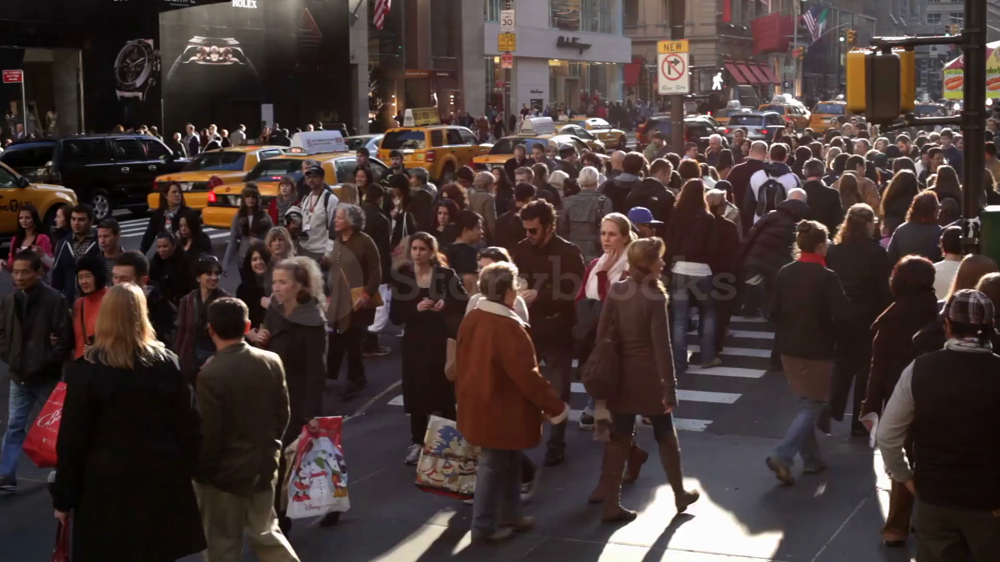

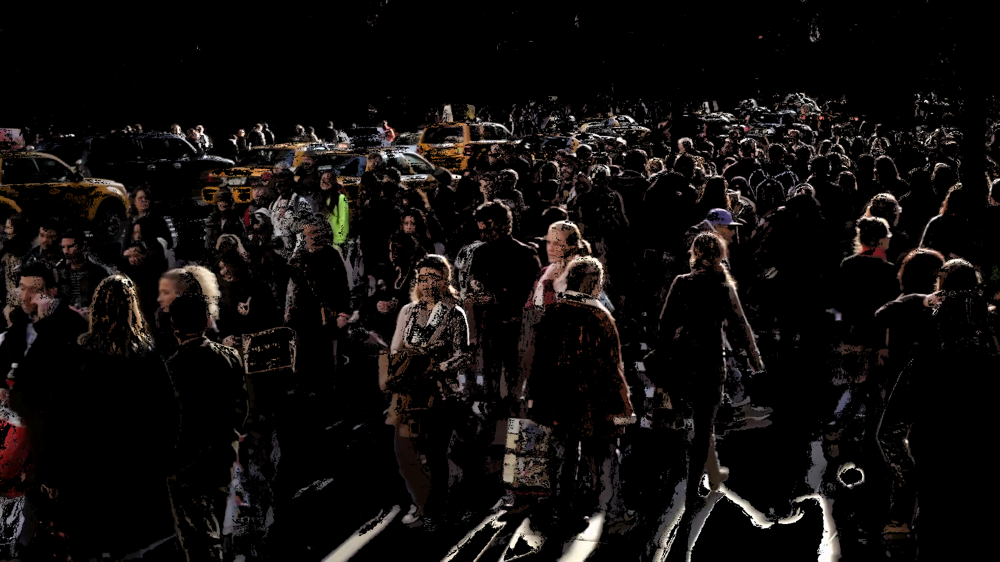

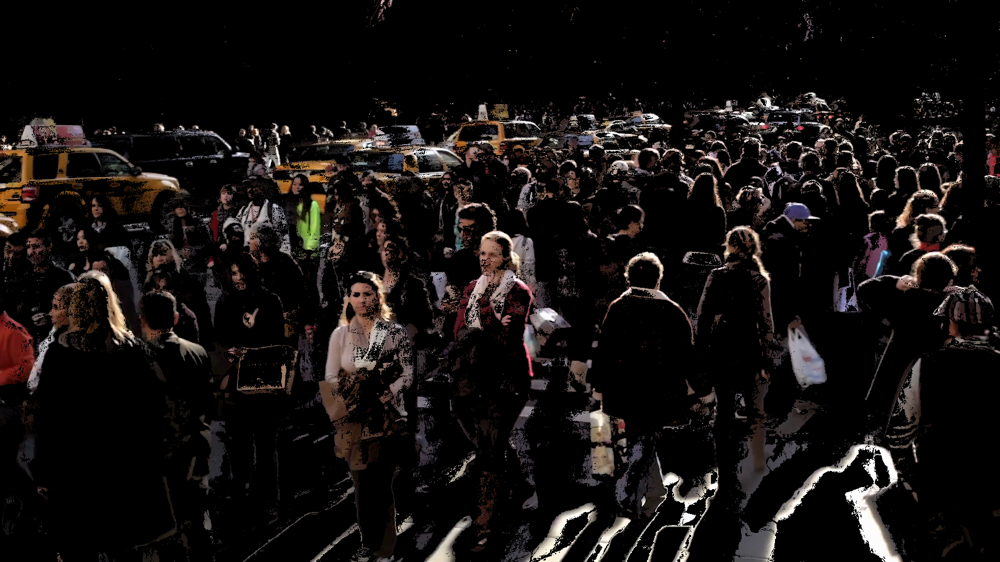

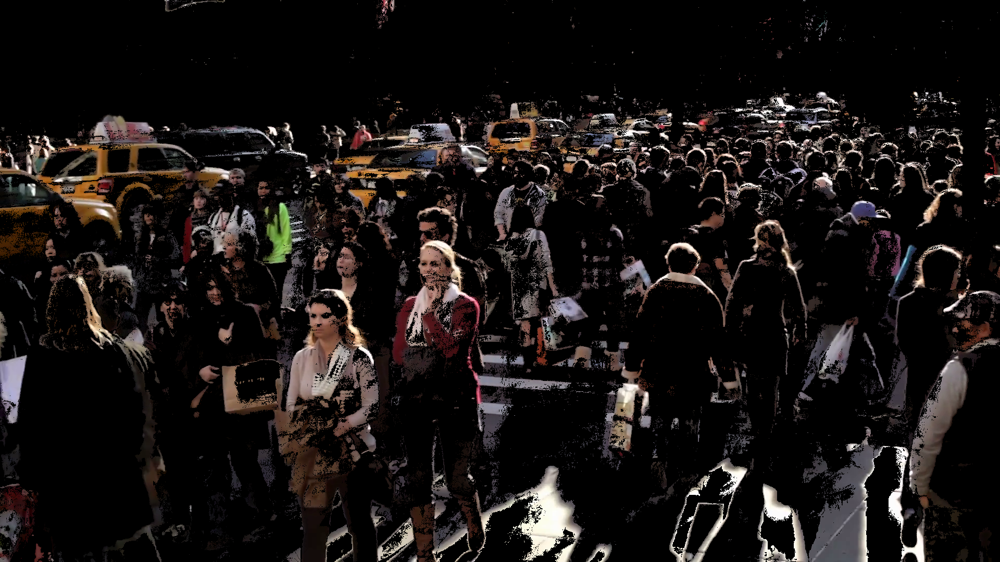

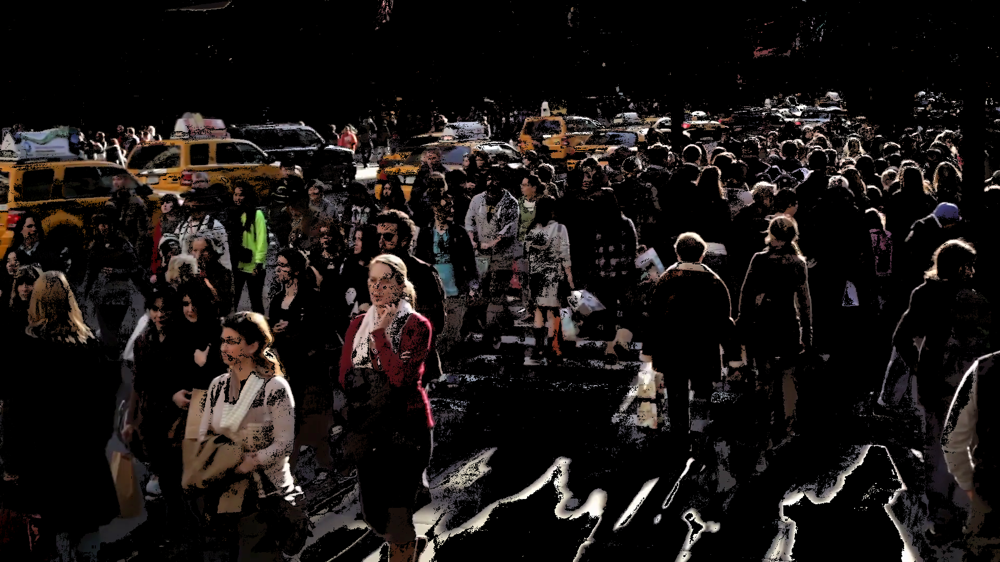

In [5]:
#open video file ->setting parameter of video capture ->  generate of background remover object
# apply it to captured image
cap = cv2.VideoCapture(video_path)
if not cap.isOpened() :
  print(f"can't open video")
  exit()

frame_count = 0
MAX_FRAMES = 100
EVERY_N_FRAME = 20

fgbg = cv2.createBackgroundSubtractorMOG2()

while cap.isOpened() and frame_count < MAX_FRAMES :
  ret, frame = cap.read()
  if not ret :
    break

  mask = fgbg.apply(frame)
  fg = cv2.bitwise_and(frame,frame,mask=mask)

  if not(frame_count % EVERY_N_FRAME) :
    cv2_imshow(fg)
    time.sleep(1)
  frame_count += 1
cap.release()


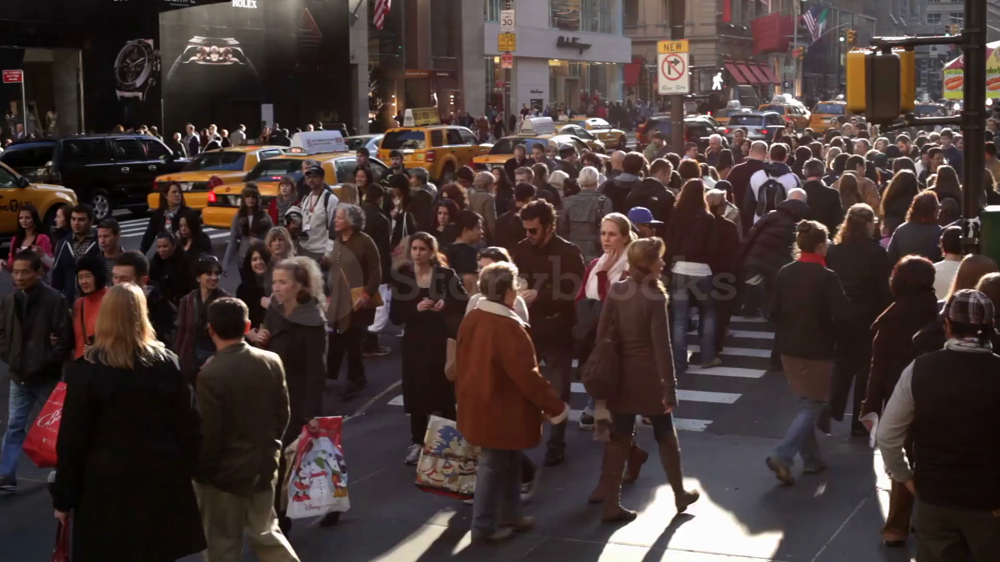

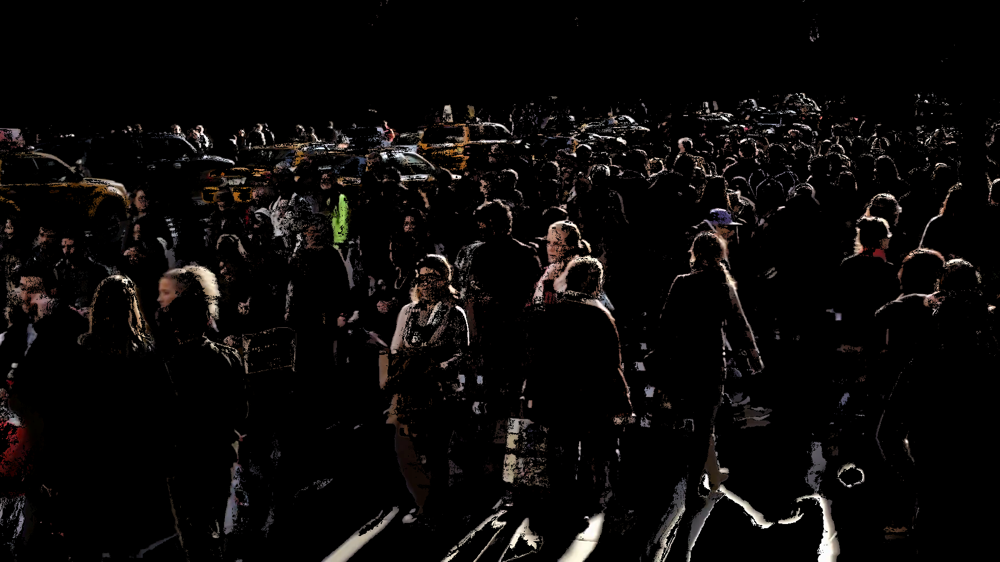

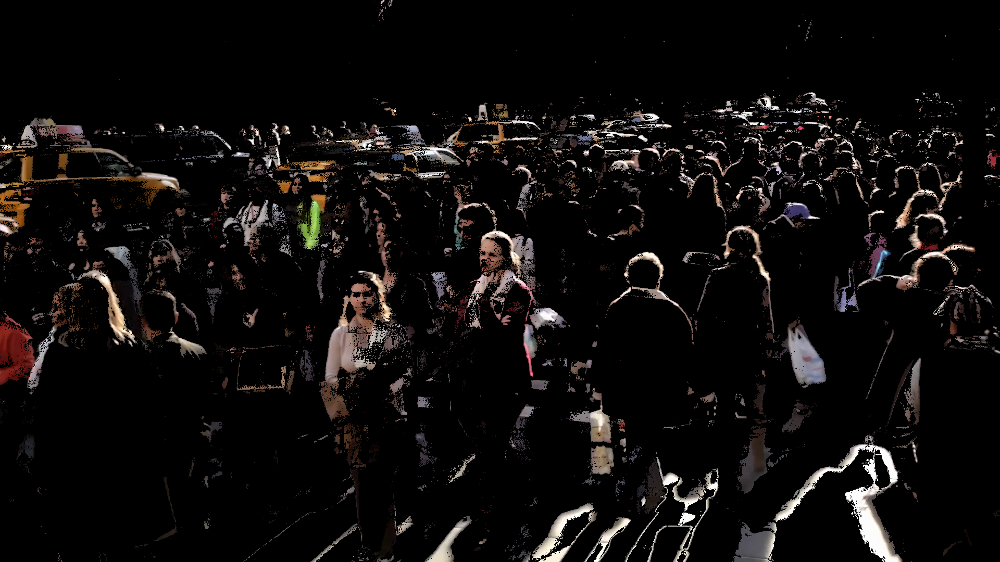

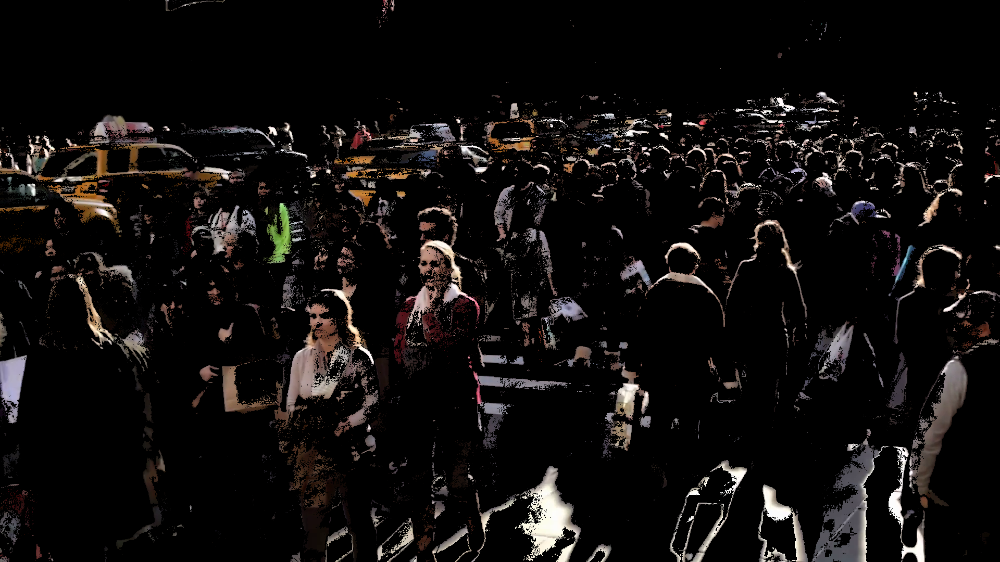

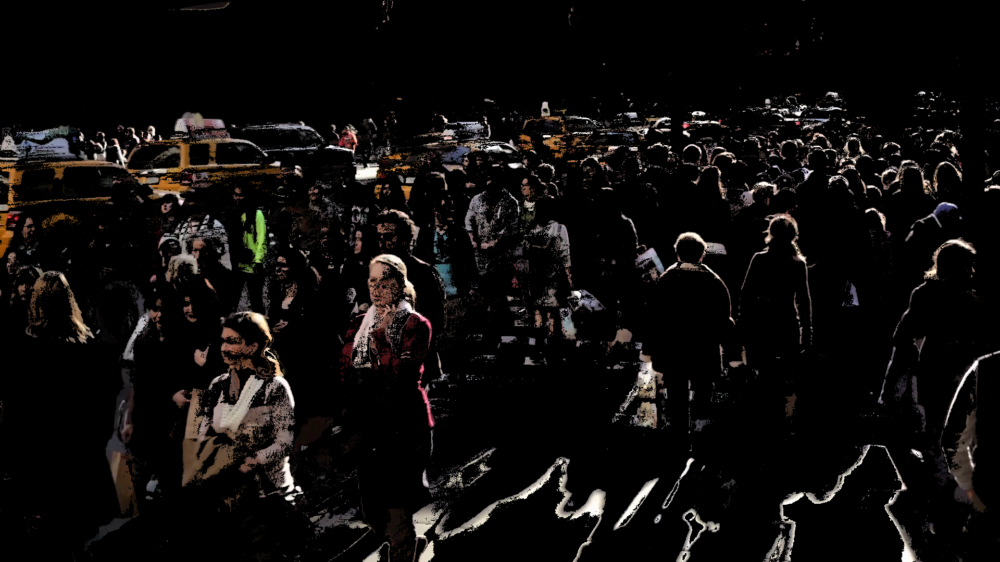

In [8]:
# history : how many frames they will refer to estiamte background
# varThreshold -> criterion
cap = cv2.VideoCapture(video_path)
if not cap.isOpened() :
  print(f"can't open video")
  exit()

frame_count = 0
MAX_FRAMES = 100
EVERY_N_FRAME = 20

fgbg = cv2.createBackgroundSubtractorMOG2(history=100,varThreshold=50,detectShadows=False)

while cap.isOpened() and frame_count < MAX_FRAMES :
  ret, frame = cap.read()
  if not ret :
    break

  mask = fgbg.apply(frame)
  _, mask = cv2.threshold(mask,200,255,cv2.THRESH_BINARY)
  fg = cv2.bitwise_and(frame,frame,mask=mask)

  if not(frame_count % EVERY_N_FRAME) :
    cv2_imshow(fg)
    time.sleep(1)
  frame_count += 1
cap.release()


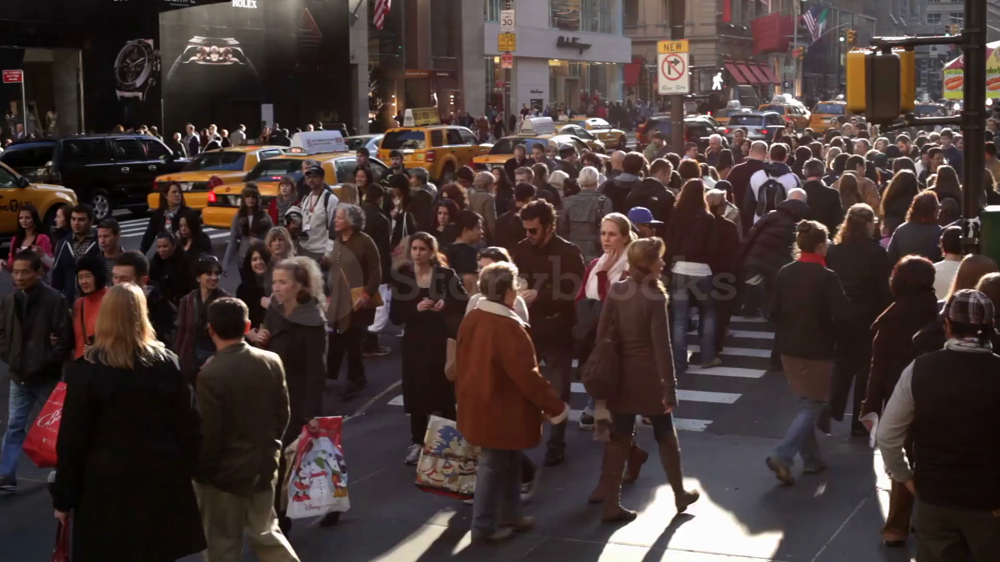

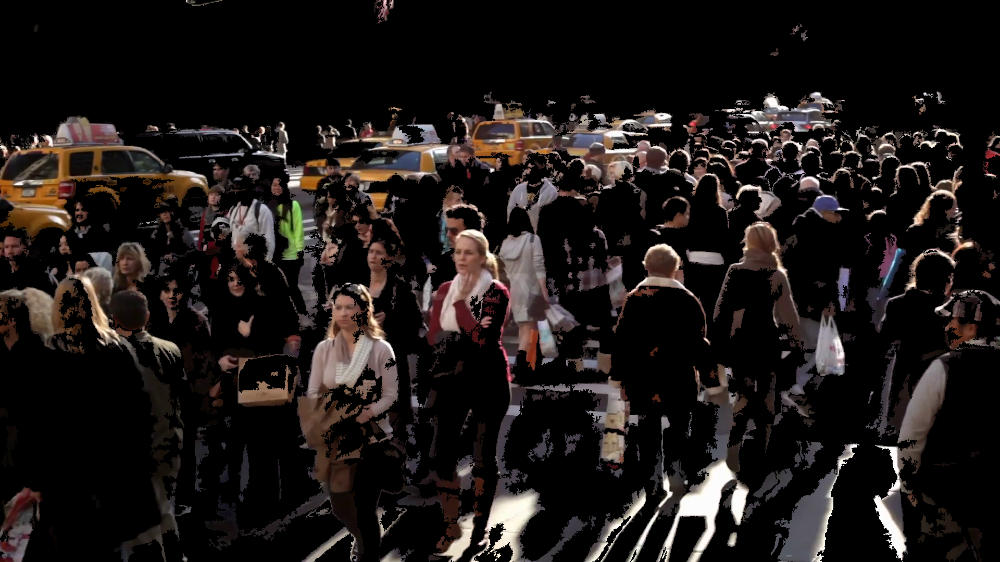

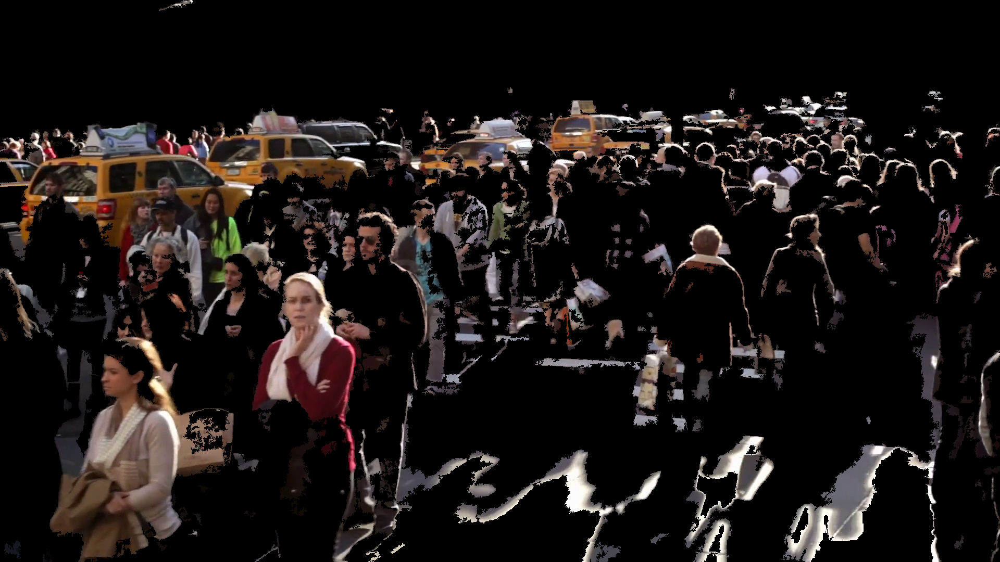

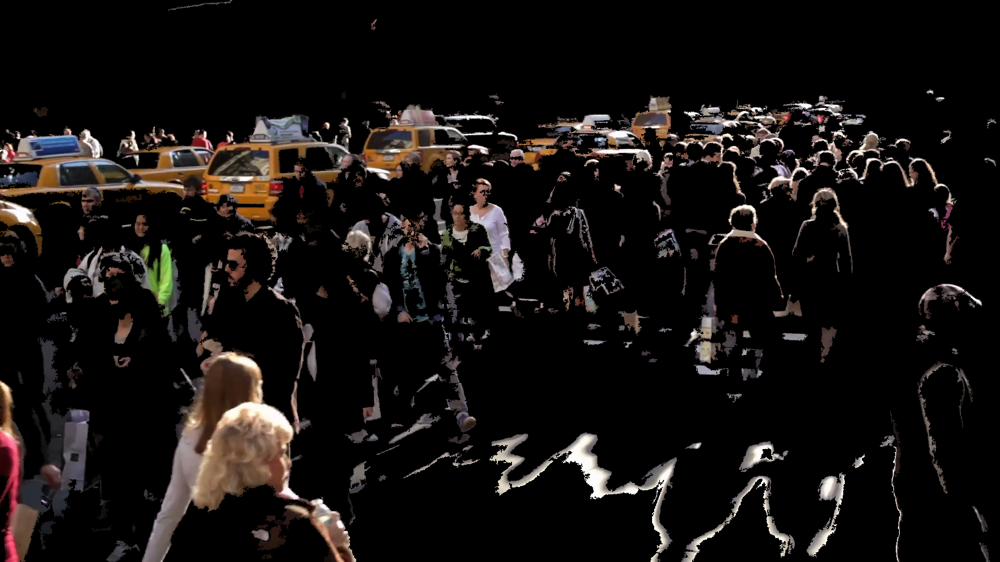

In [25]:
#open video file ->setting parameter of video capture ->  generate of background remover object
# apply it to captured image
cap = cv2.VideoCapture(video_path)
if not cap.isOpened() :
  print(f"can't open video")
  exit()

frame_count = 0
MAX_FRAMES = 200
EVERY_N_FRAME = 50
MIN_AREA = 50 # based area that will be considered as noise
TEMPORAL_ALPHA = 0.3 # trust of previous frame(high- ignore people appearing in sudden)

prev_mask = None
fgbg = cv2.createBackgroundSubtractorMOG2(history=100,varThreshold=10,detectShadows=False)

while cap.isOpened() and frame_count < MAX_FRAMES :
  ret, frame = cap.read()
  if not ret :
    break

  mask = fgbg.apply(frame)
  _, mask = cv2.threshold(mask,150,255,cv2.THRESH_BINARY)

  contours, _ = cv2.findContours(
      mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE
  )

  clean_mask = np.zeros_like(mask)
  for cnt in contours:
    if cv2.contourArea(cnt) > MIN_AREA:
      cv2.drawContours(clean_mask, [cnt],-1,255,-1)

  mask = clean_mask

  if prev_mask is None:
    smooth_mask = mask
  else :
    smooth_mask = cv2.addWeighted(
        prev_mask, TEMPORAL_ALPHA,
        mask, 1 - TEMPORAL_ALPHA,0
    )
    prev_mask = smooth_mask.copy()



  fg = cv2.bitwise_and(frame,frame,mask=smooth_mask.astype(np.uint8))

  if not(frame_count % EVERY_N_FRAME) :
    cv2_imshow(fg)
    time.sleep(1)
  frame_count += 1
cap.release()
